In [1]:
import os
import re
import time
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
from math import radians, cos, sin, asin, sqrt

In [2]:
def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance between two points 
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])
    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles
    return c * r

In [3]:
def make_haversine_matrix(coords):
    # coordinates_list is a list of (lon,lat) tuples.
    X = np.zeros((len(coords), len(coords)))
    for i, (lon1,lat1) in enumerate(coords):
        for j, (lon2,lat2) in enumerate(coords):
            X[i,j] = haversine(lon1,lat1,lon2,lat2)
    return X

In [4]:
def minimum_spanning_tree(X): 
    '''
    Prim's algorithm
    '''
    X = X.copy()
    n_vertices = X.shape[0]
    spanning_edges = []
    total_cost = 0
    # Initialize with node 0
    visited_vertices = [0]
    num_visited = 1
    #exclude self connections
    diag_indices = np.arange(n_vertices)
    X[diag_indices, diag_indices] = np.inf
    while num_visited != n_vertices:
        # Take the argmin of the flattened array of visited vertices
        min_edge = np.argmin(X[visited_vertices], axis=None)
        # Convert index to 2D encoding
        min_edge = divmod(min_edge, n_vertices)
        # Create new edge
        source, sink = visited_vertices[min_edge[0]], min_edge[1]
        # Add edge to the tree
        spanning_edges.append([source,sink])
        visited_vertices.append(sink)
        total_cost += X[source,sink] 
        # Remove all edges inside current tree
        X[visited_vertices, sink] = np.inf
        X[sink, visited_vertices] = np.inf
        num_visited+=1
    
    if len(spanning_edges) == 0:
        return np.array(spanning_edges), total_cost
    return np.vstack(spanning_edges), total_cost

In [5]:
def plot_mst(coords, mst_edges, total_cost, plot_title=None, box_text=None):
    
    plt.figure(figsize=(20,20))
    # Miller projection
    m = Basemap(projection='mill', llcrnrlat=-60, urcrnrlat=90, llcrnrlon=-180, urcrnrlon=180, resolution='c')
    m.drawcoastlines()
    m.drawcountries()
    m.fillcontinents(color='#04BAE3', lake_color='#FFFFFF')
    m.drawmapboundary(fill_color='#FFFFFF')
    
    if len(mst_edges) == 0:
        for c in coords:
            x,y = m(c[0], c[1])
            m.plot(x,y, marker='o', color='r', markersize=7, alpha=1)
            
    for source,sink in mst_edges:
        lon1, lat1 = coords[source][0], coords[source][1]
        x1,y1 = m(lon1,lat1)
        lon2, lat2 = coords[sink][0], coords[sink][1]
        x2,y2 = m(lon2,lat2)
        
        m.plot([x1,x2],[y1,y2],marker='o', color='r',markersize=7, alpha=1)
    
    if total_cost != None:
        plt.annotate('Cost: %0.2f km'%total_cost, xy=(0.02, 0.05), xycoords='axes fraction', 
                     fontsize=20, fontweight='bold', color='r',
                     bbox=dict(facecolor='none', edgecolor='black', pad=10.0))
    
    if box_text != None:
        plt.annotate(box_text, xy=(0.02, 0.05), xycoords='axes fraction', 
                     fontsize=20, fontweight='bold', color='r', 
                     bbox=dict(facecolor='none', edgecolor='black', pad=10.0))

    
    if plot_title:
        plt.title(plot_title, fontweight='bold')
    plt.show()

In [6]:
class Toponym:
    def __init__(self, name, annotator_notes):
        self.name = re.sub(r'([^\s\w]|_)+', '', name)
        
        # Latitude and Longitude (may be non-existent)
        latlon = re.findall(r'<latlng>(.*?)</latlng>', annotator_notes)
        if len(latlon) != 0 and latlon[0] != 'NA':
            latlon = latlon[0].split(',')
            self.lat, self.lon = float(latlon[0]), float(latlon[1])
        else:
            self.lat, self.lon = 'NA', 'NA'

        # Population (tag may be non-existent)
        pop = re.findall(r'<pop>(.*?)</pop>', annotator_notes)
        if len(pop) != 0:
            self.pop = int(pop[0])
        else:
            self.pop = 0
        
        # GeoID (some are 'NA')
        geoID = re.findall(r'<geoID>(.*?)</geoID>', annotator_notes)
        if len(geoID) != 0:
            self.geoID = geoID[0]
        else:
            self.geoID = 'NA'

In [7]:
def get_protein_intervals(annotation_file):
    '''
    The Protein tag is used to mark continuous spans of text that will be 
    excluded from the evaluation, such spans are names of authors, reference, 
    footnotes etc. They have been excluded from the annotations since they 
    would not contain toponyms related to the biological content of the articles. 
    Continuing with the article PMC2816729 as an example, the PMC2816729.ann file 
    starts with the lines:

    T1    Protein 0 8    American
    #1    AnnotatorNotes T1    BEGIN
    T2    Protein 559 571    Contribution
    #2    AnnotatorNotes T2    END
    '''
    intervals_to_exclude = []
    with open(annotation_file,'r') as infile:
        for line in infile:
            line = line.rstrip()
            if 'Protein' in line:
                start = int(line.split('\t')[1].split(' ')[1])
                #print(line.rstrip())
                while 'END' not in line:
                    previous_line = line
                    line = next(infile).rstrip()
                    #print(line)
                end = int(previous_line.split('\t')[1].split(' ')[2])
                #print(start, end)
                intervals_to_exclude.append((start,end))
    return intervals_to_exclude

In [8]:
def get_toponym_list(filepath):
    intervals_to_exclude = get_protein_intervals(filepath)
    toponym_list = []
    with open(filepath, 'r') as infile:        
        for line in infile:
            if 'Location' in line:
                data = line.rstrip().split('\t')
                
                try:
                    next_line = next(infile).rstrip()
                    annotator_notes = next_line.split('\t')[2]
                    placename = data[2]
                except IndexError as e:
                    print('Annotator notes messed up.\nLine: "%s".\nSee file %s'%(next_line,filepath))
                    time.sleep(500)

                # Hacky way to remove all but lower bound and upper bound. 
                # For example: ['Location', '42514', '42520;42521', '42528']
                start,end = [int(x) for x in data[1].split(' ') if ';' not in x and x !='Location']            

                # If this Location tag is a protein, exclude it. 
                for lower,upper in intervals_to_exclude:
                    if start >= lower and end <= upper:
                        continue
                # Else, add it to the list of toponyms.
                toponym_list.append(Toponym(placename, annotator_notes))
                
    return toponym_list

In [9]:
geonames_header = ['geonameid','name','asciiname','alternatenames','latitude','longitude','feature_class','feature_code','country_code','cc2','admin1_code','admin2_code','admin3_code','admin4_code','population', 'elevation', 'dem', 'timezone', 'modification_date']
print('Geonames header:')
for i,g in enumerate(geonames_header):
    print('%s) %s'%(i,g))

Geonames header:
0) geonameid
1) name
2) asciiname
3) alternatenames
4) latitude
5) longitude
6) feature_class
7) feature_code
8) country_code
9) cc2
10) admin1_code
11) admin2_code
12) admin3_code
13) admin4_code
14) population
15) elevation
16) dem
17) timezone
18) modification_date


In [10]:
s=time.time()
place_dict = {}

# Geonames database
threshold = 10
filename = '/home/julyankb/Workspace/COMP550/final_proj/geonames/allCountries.txt'
with open(filename, 'r') as infile:
    for i,line in enumerate(infile):
        data = line.split('\t')
        geoID = data[0]
        #asciiname = data[2]
        asciiname = re.sub(r'([^\s\w]|_)+', '', data[2]).lower()
        lat = np.float16(data[4])
        lon = np.float16(data[5])
        pop = int(data[14])
        feature_class = data[6]
#         if feature_class != 'A':
#             continue
        
        if pop == 0:
            continue
        if asciiname not in place_dict:
            place_dict[asciiname] = [(lon, lat)]
        else:
            is_duplicate = 0
            for loc in place_dict[asciiname]:
                '''
                There is repetitive information in the database. Two ways to solve:
                1) Store lon,lat as float16
                2) Only enter new element if distance smaller than threshold.
                '''
                if abs(lon - loc[0]) < threshold and abs(lat - loc[1]) < threshold:
                    is_duplicate = 1
                    break
                
            if not is_duplicate:
                place_dict[asciiname].append((lon, lat))

# All countries                
with open('countries.csv', 'r') as infile:
    next(infile)
    for line in infile:
        data = line.rstrip().split('\t')
        name = data[3].lower()
        try:
            lat = float(data[1])
            lon = float(data[2])
        except:
            continue
        if name not in place_dict:
            place_dict[name] = [(lon,lat)]
        else:
            place_dict[name].append((lon,lat))
        
# Canadian Provinces
with open('canada.csv', 'r') as infile:
    next(infile)
    for line in infile:
        data = line.split(',')
        province = data[5].lower()
        lon,lat = float(data[2]), float(data[1])
        if province not in place_dict:
            #print(province)
            place_dict[province] = [(lon,lat)]
        else:
            is_duplicate = 0
            for loc in place_dict[province]:
                if abs(lon - loc[0]) < threshold and abs(lat - loc[1]) < threshold:
                    is_duplicate = 1
                    break
                
            if not is_duplicate:
                place_dict[province].append((lon, lat))

# Venezuela states
with open('venezuela_states.csv', 'r') as infile:
    next(infile)
    for line in infile:
        data = line.split('\t')
        state = data[0].lower()
        
        lon,lat = float(data[2]), float(data[1])
        
        if state not in place_dict:
            #print(state)
            place_dict[state] = [(lon,lat)]
        else:
            is_duplicate = 0
            for loc in place_dict[state]:
                if abs(lon - loc[0]) < threshold and abs(lat - loc[1]) < threshold:
                    is_duplicate = 1
                    break
                
            if not is_duplicate:
                place_dict[state].append((lon, lat))
        
# MANUAL ENTRIES TO DICT THAT WERE NOT IN GEONAMES DATABASE
place_dict['latin america'] = [(-61.3269, -4.4420)]
place_dict['israel'] = place_dict['palestine']

for k,v in place_dict.items():
    place_dict[k] = tuple(v)
print('Time to load dict to memory:',time.time()-s)

Time to load dict to memory: 51.79501557350159


In [11]:
# In papers, states are sometimes abbreviated by statecodes. 
statecode_to_state = {
    'AL': 'Alabama',
    'AK': 'Alaska',
    'AZ': 'Arizona',
    'AR': 'Arkansas',
    'CA': 'California',
    'CO': 'Colorado',
    'CT': 'Connecticut',
    'DE': 'Delaware',
    'FL': 'Florida',
    'GA': 'Georgia',
    'HI': 'Hawaii',
    'ID': 'Idaho',
    'IL': 'Illinois',
    'IN': 'Indiana',
    'IA': 'Iowa',
    'KS': 'Kansas',
    'KY': 'Kentucky',
    'LA': 'Louisiana',
    'ME': 'Maine',
    'MD': 'Maryland',
    'MA': 'Massachusetts',
    'MI': 'Michigan',
    'MN': 'Minnesota',
    'MS': 'Mississippi',
    'MO': 'Missouri',
    'MT': 'Montana',
    'NE': 'Nebraska',
    'NV': 'Nevada',
    'NH': 'New Hampshire',
    'NJ': 'New Jersey',
    'NM': 'New Mexico',
    'NY': 'New York',
    'NC': 'North Carolina',
    'ND': 'North Dakota',
    'OH': 'Ohio',
    'OK': 'Oklahoma',
    'OR': 'Oregon',
    'PA': 'Pennsylvania',
    'RI': 'Rhode Island',
    'SC': 'South Carolina',
    'SD': 'South Dakota',
    'TN': 'Tennessee',
    'TX': 'Texas',
    'UT': 'Utah',
    'VT': 'Vermont',
    'VA': 'Virginia',
    'WA': 'Washington',
    'WV': 'West Virginia',
    'WI': 'Wisconsin',
    'WY': 'Wyoming'}

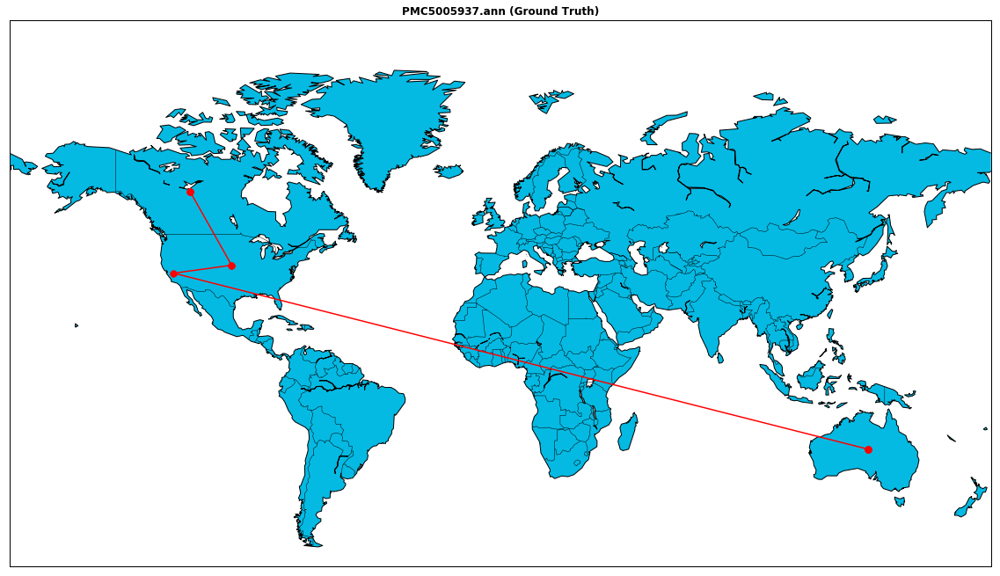

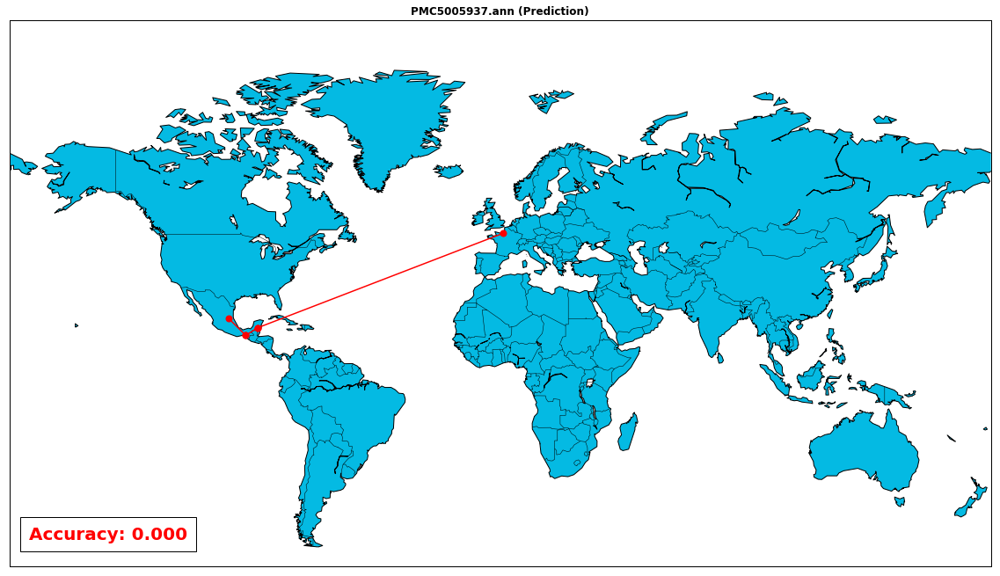

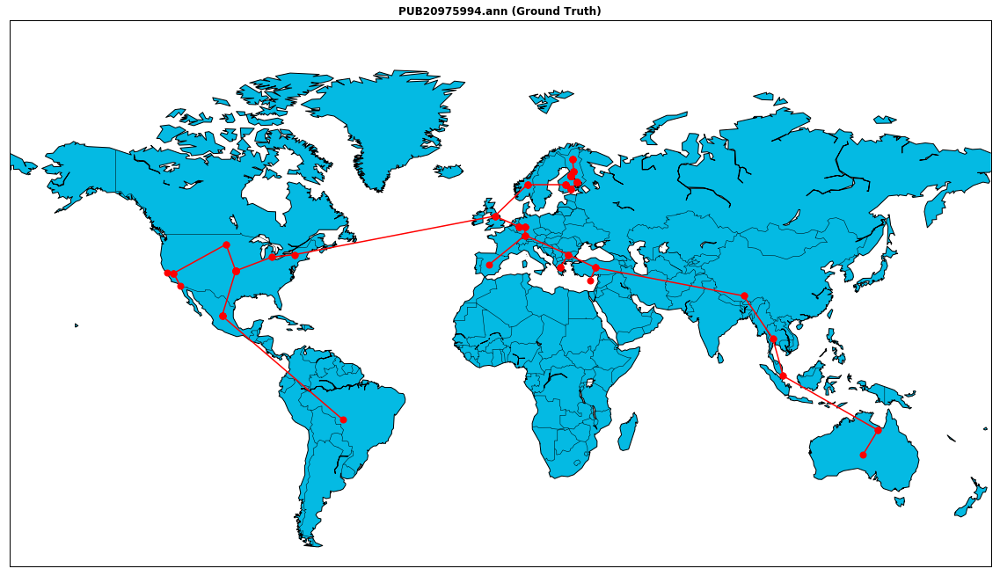

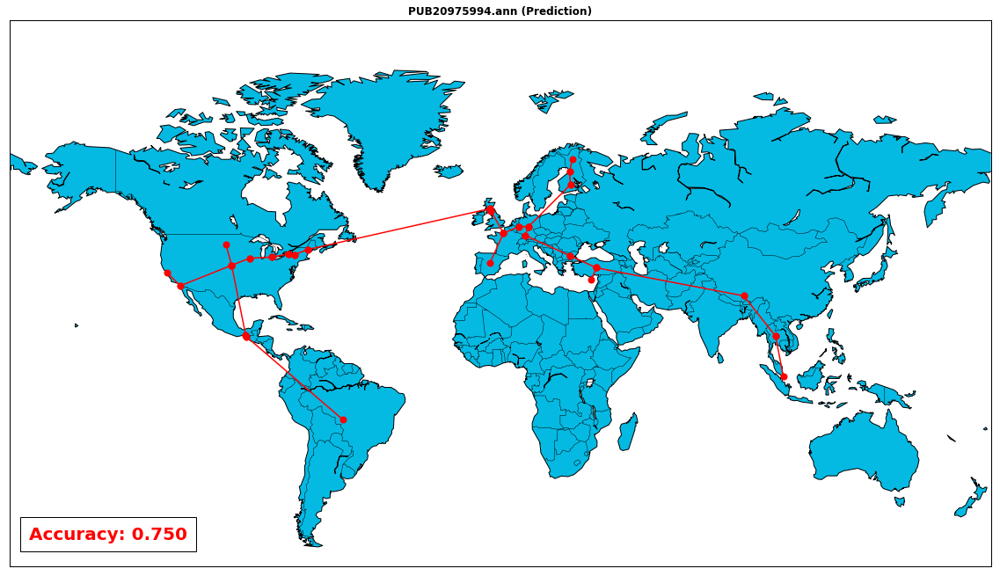

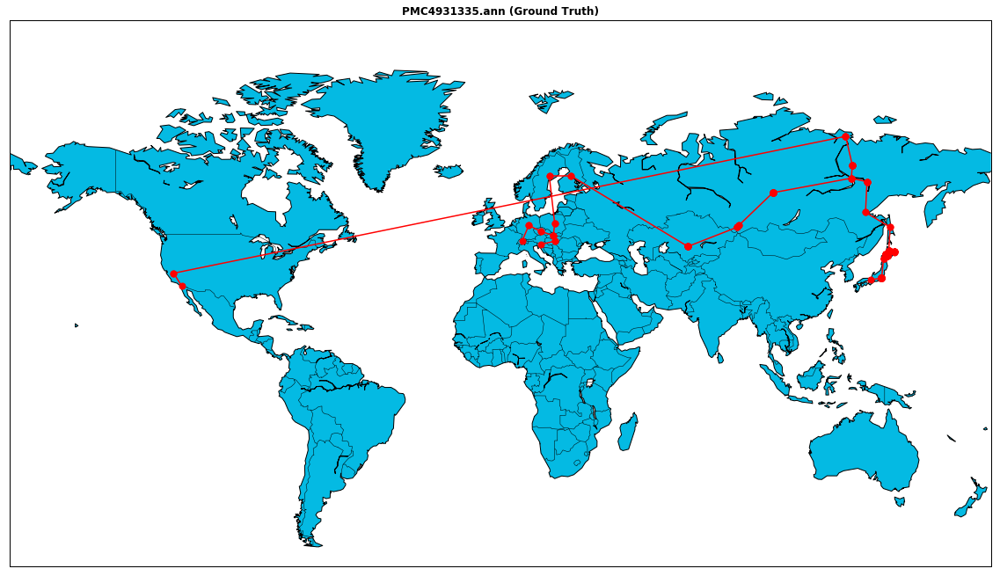

...

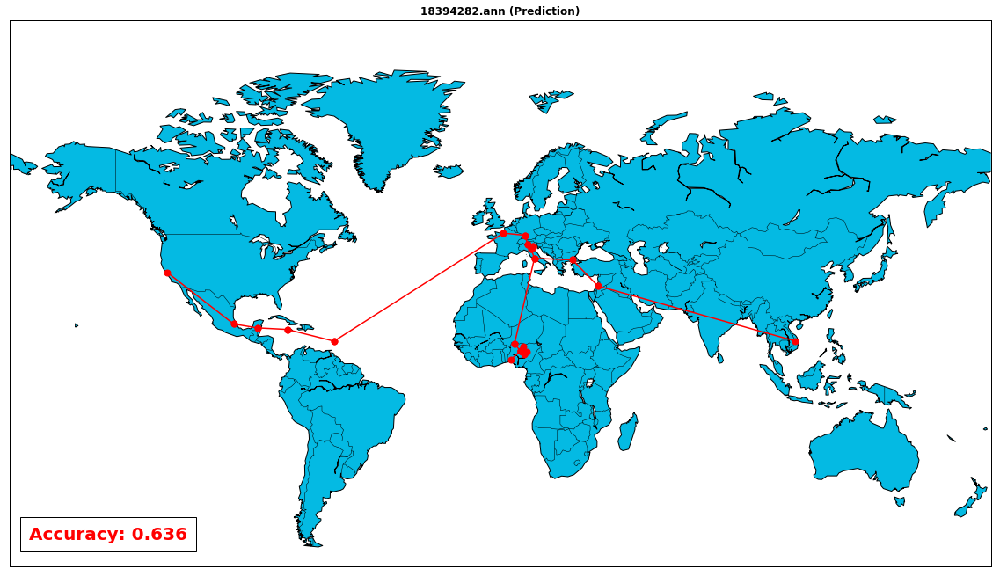

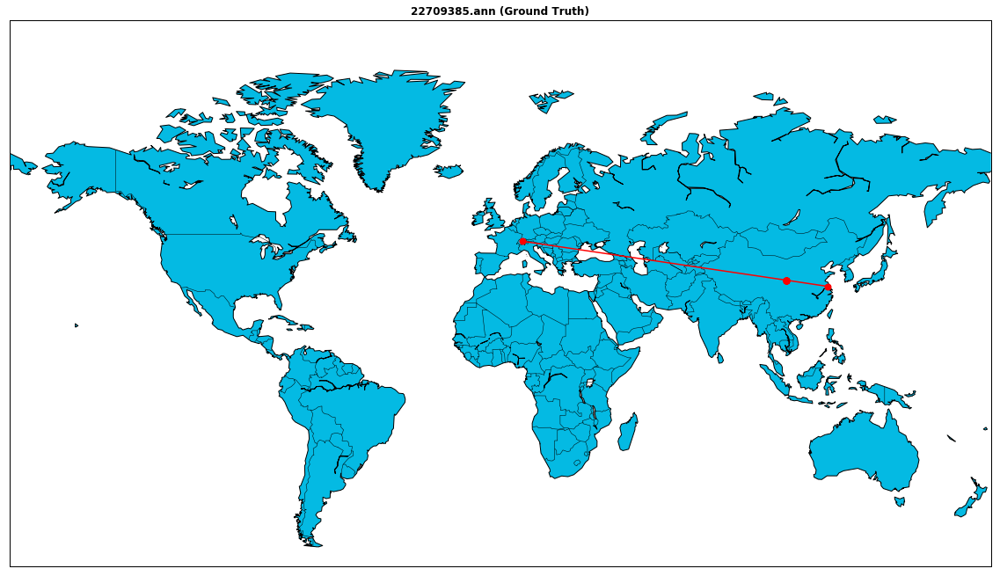

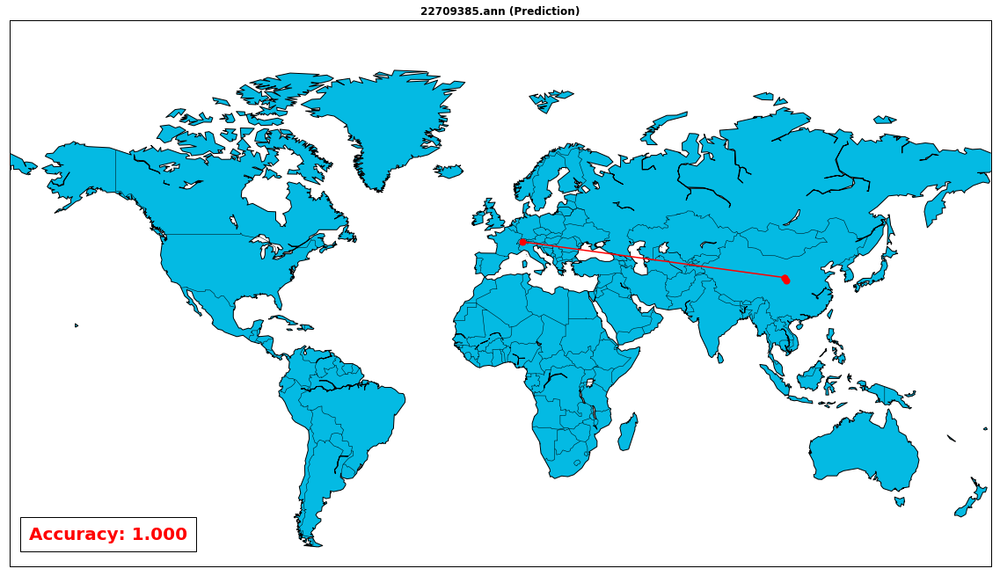

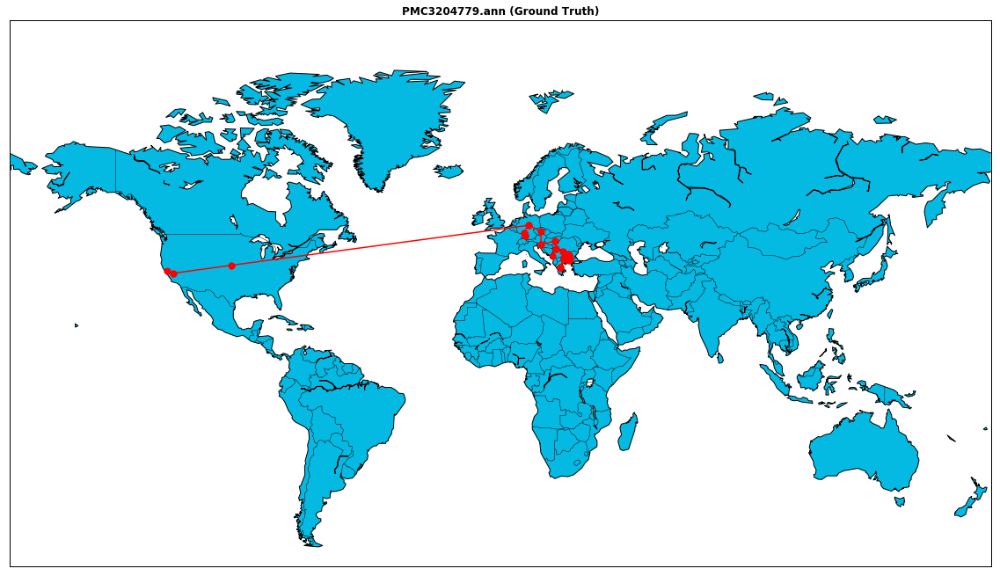

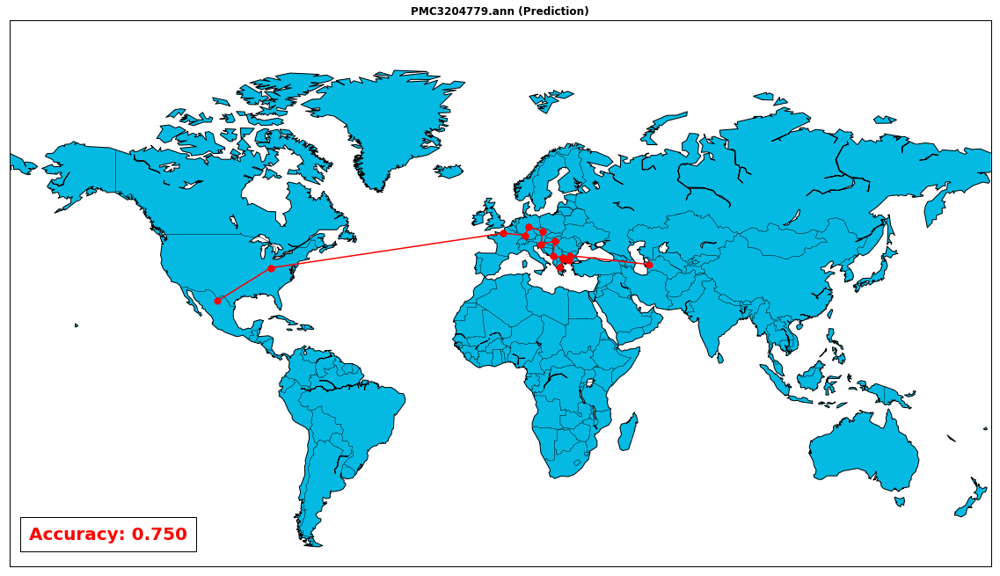

0.6548901648708804


In [12]:
total_acc = 0
filedir = '/home/julyankb/Workspace/COMP550/final_proj/Training-20181121T061157Z-001/Training/Training_Data_Participant/'
files = [f for f in os.listdir(filedir) if '.ann' in f]
for count, filename in enumerate(files):
    
    coords = []
    placenames = []
    ground_truth = {}
    
    toponym_list = get_toponym_list(filedir+filename)
    if len(toponym_list) == 0:
        continue
    
    for t in toponym_list:
        # If the longitude and latitude are existent, consider the toponym. 
        if t.lon != 'NA' and t.lat != 'NA':
            # Make sure coordinates are possible, ie. abs(lat) < 90 abs(lon) < 180
            if (-180 <= t.lon <= 180) and (-90 <= t.lat <= 90):
                coords.append((t.lon, t.lat))
                if t.name in statecode_to_state:
                    placenames.append(statecode_to_state[t.name].lower())
                    ground_truth[statecode_to_state[t.name].lower()] = (t.lon, t.lat)
                else:
                    placenames.append(t.name.lower())
                    ground_truth[t.name.lower()] = (t.lon, t.lat)
    
# ==========================================================================================
#     #Here, we assign lon,lat=(0,0) if location not in database. 
#     #This has pros and cons.
#     #If we do this, we are underestimating accuracy of our predictor by attempting to predict toponyms that are not real locations. 
#     toponym_coordlists = []
#     placenames = list(set(placenames))
#     for place in placenames:
#         if place in place_dict:
#             toponym_coordlists.append(place_dict[place])
#         else:
#             toponym_coordlists.append(tuple([(0,0)]))
#             continue
# ==========================================================================================
    # Here, we exclude toponyms that do not exist in our database. 
    # Doing this has pros and cons. 
    # The pro is that we do not try to predict toponyms that are not locations such as proper names.
    # The con is that we may be missing a location in our database and we are overestimating accuracy. 
    toponym_coordlists = []
    
    placenames = list(set(placenames))
    placenames_toremove = []
    for i,place in enumerate(placenames):
        if place in place_dict:
            toponym_coordlists.append(place_dict[place])
        else:
            # The toponym is not in our database.
            placenames_toremove.append(i)
            continue
    
    placenames = [p for i,p in enumerate(placenames) if i not in placenames_toremove]
# ==========================================================================================

    new_placenames = []
    new_coords = []
    for place,t in zip(placenames,toponym_coordlists):
        if len(t) == 1:
            new_coords.append(t[0])
            new_placenames.append(place)

    for place, t in zip(placenames,toponym_coordlists):
        if len(t) > 1:
            min_cost, min_coord = np.inf, None
            for coord in t:
                temp = new_coords + [coord]
                haversine_matrix = make_haversine_matrix(temp)
                mst_edges, total_cost = minimum_spanning_tree(haversine_matrix)
                if total_cost < min_cost:
                    min_cost = total_cost
                    min_coord = coord
            new_coords.append(min_coord)
            new_placenames.append(place)
    
    total_predictions = 0
    correct_predictions = 0
    for name,c in zip(new_placenames, new_coords):
        #print(name)
        if np.linalg.norm(abs(np.array(c) - np.array(ground_truth[name]))) < 10:
            correct_predictions +=1
        total_predictions +=1

    accuracy = correct_predictions/total_predictions
    total_acc += accuracy
    
    for _, c in zip(['Ground Truth', 'Prediction'],[coords, new_coords]):
        haversine_matrix = make_haversine_matrix(c)
        mst_edges, total_cost = minimum_spanning_tree(haversine_matrix)

        if _ == 'Prediction':
            plot_mst(c, mst_edges, total_cost=None, plot_title='%s (%s)'%(filename,_), 
                     box_text='Accuracy: %0.3f'%accuracy)
        else:
            plot_mst(c, mst_edges, total_cost=None, plot_title='%s (%s)'%(filename,_))


            
print(total_acc/count)

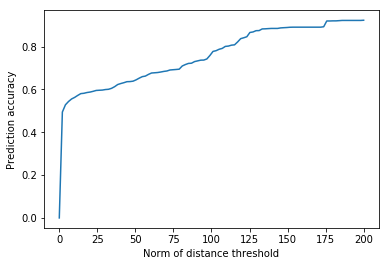

In [13]:
accuracies = []
diff_thresholds = np.linspace(0,200,100)
for diff_thres in diff_thresholds:
    total_acc = 0
    filedir = '/home/julyankb/Workspace/COMP550/final_proj/Training-20181121T061157Z-001/Training/Training_Data_Participant/'
    files = [f for f in os.listdir(filedir) if '.ann' in f]
    for count, filename in enumerate(files):

        coords = []
        placenames = []
        ground_truth = {}

        toponym_list = get_toponym_list(filedir+filename)
        if len(toponym_list) == 0:
            continue

        for t in toponym_list:
            # If the longitude and latitude are existent, consider the toponym. 
            if t.lon != 'NA' and t.lat != 'NA':
                # Make sure coordinates are possible, ie. abs(lat) < 90 abs(lon) < 180
                if (-180 <= t.lon <= 180) and (-90 <= t.lat <= 90):
                    coords.append((t.lon, t.lat))
                    if t.name in statecode_to_state:
                        placenames.append(statecode_to_state[t.name].lower())
                        ground_truth[statecode_to_state[t.name].lower()] = (t.lon, t.lat)
                    else:
                        placenames.append(t.name.lower())
                        ground_truth[t.name.lower()] = (t.lon, t.lat)

        toponym_coordlists = []
        placenames = list(set(placenames))
        for place in placenames:
            if place in place_dict:
                toponym_coordlists.append(place_dict[place])
            else:
                toponym_coordlists.append(tuple([(0,0)]))
                continue


        new_placenames = []
        new_coords = []
        for place,t in zip(placenames,toponym_coordlists):
            if len(t) == 1:
                new_coords.append(t[0])
                new_placenames.append(place)

        for place, t in zip(placenames,toponym_coordlists):
            if len(t) > 1:
                min_cost, min_coord = np.inf, None
                for coord in t:
                    temp = new_coords + [coord]
                    haversine_matrix = make_haversine_matrix(temp)
                    mst_edges, total_cost = minimum_spanning_tree(haversine_matrix)
                    if total_cost < min_cost:
                        min_cost = total_cost
                        min_coord = coord
                new_coords.append(min_coord)
                new_placenames.append(place)

        total_predictions = 0
        correct_predictions = 0
        for name,c in zip(new_placenames, new_coords):
            #print('%s\t%s\t%s'%(name,c, ground_truth[name]))
            if np.linalg.norm(abs(np.array(c) - np.array(ground_truth[name]))) < diff_thres:
                correct_predictions +=1
            total_predictions +=1

        accuracy = correct_predictions/total_predictions
        total_acc += accuracy

        for _, c in zip(['Ground Truth', 'Prediction'],[coords, new_coords]):
            haversine_matrix = make_haversine_matrix(c)
            mst_edges, total_cost = minimum_spanning_tree(haversine_matrix)


    accuracies.append(total_acc/count)

plt.plot(diff_thresholds, accuracies)
plt.xlabel('Norm of distance threshold')
plt.ylabel('Prediction accuracy')
plt.show()